## Module 5: Analyse, diagnose and improve a model​

In the excercise of this week you will be working with financial data in order to (hopefully) find a portfolio of equities which outperform SP500. The data that you are gonna work with has two main sources: 
* Financial data from the companies extracted from the quarterly company reports (mostly extracted from [macrotrends](https://www.macrotrends.net/) so you can use this website to understand better the data and get insights on the features, for example [this](https://www.macrotrends.net/stocks/charts/AAPL/apple/revenue) is the one corresponding to APPLE)
* Stock prices, mostly extracted from [morningstar](https://indexes.morningstar.com/page/morningstar-indexes-empowering-investor-success?utm_source=google&utm_medium=cpc&utm_campaign=MORNI%3AG%3ASearch%3ABrand%3ACore%3AUK%20MORNI%3ABrand%3ACore%3ABroad&utm_content=engine%3Agoogle%7Ccampaignid%3A18471962329%7Cadid%3A625249340069&utm_term=morningstar%20index&gclid=CjwKCAjws9ipBhB1EiwAccEi1Fu6i20XHVcxFxuSEtJGF0If-kq5-uKnZ3rov3eRkXXFfI5j8QBtBBoCayEQAvD_BwE), which basically tell us how the stock price is evolving so we can use it both as past features and the target to predict).

Before going to the problem that we want to solve, let's comment some of the columns of the dataset:


* `Ticker`: a [short name](https://en.wikipedia.org/wiki/Ticker_symbol) to identify the equity (that you can use to search in macrotrends)
* `date`: the date of the company report (normally we are gonna have 1 every quarter). This is for informative purposes but you can ignore it when modeling.
* `execution date`: the date when we would had executed the algorithm for that equity. We want to execute the algorithm once per quarter to create the portfolio, but the release `date`s of all the different company reports don't always match for the quarter, so we just take a common `execution_date` for all of them.
* `stock_change_div_365`: what is the % change of the stock price (with dividens) in the FOLLOWING year after `execution date`. 
* `sp500_change_365`: what is the % change of the SP500 in the FOLLOWING year after `execution date`.
* `close_0`: what is the price at the moment of `execution date`
* `stock_change__minus_120` what is the % change of the stock price in the last 120 days
* `stock_change__minus_730`: what is the % change of the stock price in the last 730 days

The rest of the features can be divided beteween financial features (the ones coming from the reports) and technical features (coming from the stock price). We leave the technical features here as a reference: 

In [1]:
technical_features = ['close_0', 'close_sp500_0', 'close_365', 'close_sp500_365',
       'close__minus_120', 'close_sp500__minus_120', 'close__minus_365',
       'close_sp500__minus_365', 'close__minus_730', 'close_sp500__minus_730',
       'stock_change_365','stock_change_div_365', 'sp500_change_365', 'stock_change__minus_120',
       'sp500_change__minus_120', 'stock_change__minus_365',
       'sp500_change__minus_365', 'stock_change__minus_730','sp500_change__minus_730',
       'std__minus_365','std__minus_730','std__minus_120']

The problem that we want to solve is basically find a portfolio of `top_n` tickers (initially set to 10) to invest every `execution date` (basically once per quarter) and the goal is to have a better return than `SP500` in the following year. The initial way to model this is to have a binary target which is 1 when `stock_change_div_365` - `sp500_change_365` (the difference between the return of the equity and the SP500 in the following year) is positive or 0 otherwise. So we try to predict the probability of an equity of improving SP500 in the following year, we take the `top_n` equities and compute their final return.

In [2]:
import pandas as pd
import re
import numpy as np
import lightgbm as lgb
from plotnine import ggplot, geom_histogram, aes, geom_col, coord_flip,geom_bar,scale_x_discrete, geom_point, theme,element_text

In [3]:
# number of trees in lightgbm
n_trees = 40
minimum_number_of_tickers = 1500
# Number of the quarters in the past to train
n_train_quarters = 36
# number of tickers to make the portfolio
top_n = 10

In [4]:
data_set = pd.read_feather("data/financials_against_return.feather")

Remove these quarters which have les than `minimum_number_of_tickers` tickers:

In [5]:
df_quarter_lengths = data_set.groupby(["execution_date"]).size().reset_index().rename(columns = {0:"count"})
data_set = pd.merge(data_set, df_quarter_lengths, on = ["execution_date"])
data_set = data_set[data_set["count"]>=minimum_number_of_tickers]

In [6]:
data_set.shape

(170483, 145)

Create the target:

In [7]:
data_set["diff_ch_sp500"] = data_set["stock_change_div_365"] - data_set["sp500_change_365"]

data_set.loc[data_set["diff_ch_sp500"]>0,"target"] = 1
data_set.loc[data_set["diff_ch_sp500"]<0,"target"] = 0

data_set["target"].value_counts()

target
0.0    82437
1.0    73829
Name: count, dtype: int64

## some of my code, all of it is at the end:

this is to get a cleaned df, with only 100 tickers based on the goal, and with no Nans

N tickers:  100


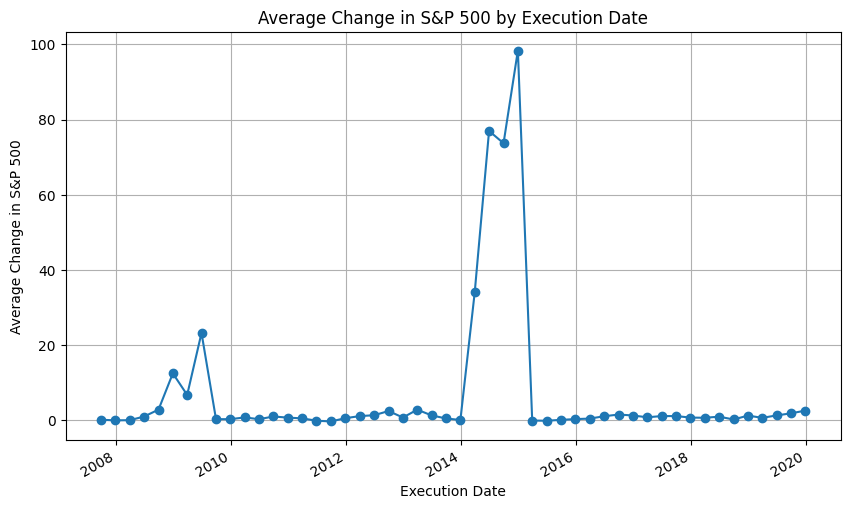

consecutive nans: std_730                     337
sp500_change_730            267
stock_change_730            267
stock_change_div_730        267
CommonStockDividendsPaid     17
                           ... 
n_finan_prev_year             0
PE                            0
sp500_change__minus_730       0
Market_cap                    0
NetIncomeLoss                 0
Length: 136, dtype: int64


<Figure size 1200x600 with 0 Axes>

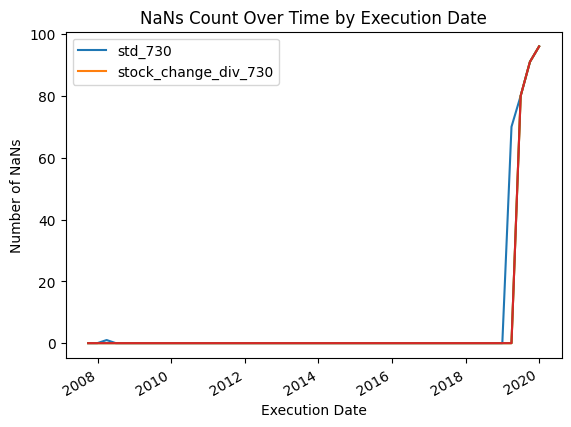

LongTermDebt                       5
Long_minus_termDebtCapital         5
ComprehensiveIncome                2
FinancialActivities_minus_Other    1
InvestingActivities_minus_Other    1
                                  ..
NetTotalEquityIssuedRepurchased    0
NetProfitMargin                    0
NetIncomeLoss                      0
NetIncome                          0
ROI_minus_ReturnOnInvestment       0
Length: 136, dtype: int64
total nans:  0


In [8]:
import pandas as pd
import numpy as np
import logging
import matplotlib.pyplot as plt
from sklearn.neighbors import LocalOutlierFactor

logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')
df = pd.DataFrame(data_set)
df_copy=df.copy()
nans_per_feature = df.isna().sum()

#getting out features over this threshold
threshold = len(df_copy) * 0.5
features_to_drop = nans_per_feature[nans_per_feature > threshold].index
df_cleaned = df_copy.drop(columns=features_to_drop)

#there is features with values from even two years before in time. Of course these will be Nan for the first years since there
#is no records of values. So let's get ride of the two first years in the datset
df_cleaned['execution_date'] = pd.to_datetime(df_cleaned['execution_date'])
cutoff_date = df_cleaned['execution_date'].min() + pd.DateOffset(years=2)
df_cleaned = df_cleaned[df_cleaned['execution_date'] > cutoff_date]

#same idea here, the last year has features with values of the following year (one of these used to calculate the target)
max_date = df_cleaned['execution_date'].max()
one_year_before_max = max_date - pd.DateOffset(years=1)
df_cleaned = df_cleaned[df_cleaned['execution_date'] <= one_year_before_max]




#if for any of these features are missing values, : LOFC
nans_stock_change = df_cleaned['stock_change_div_365'].isna().sum()
nans_sp500_change = df_cleaned['sp500_change_365'].isna().sum()
df_cleaned['stock_change_div_365'] = df_cleaned['stock_change_div_365'].fillna(df_cleaned['stock_change_div_365'].median())
lof = LocalOutlierFactor()
outliers = lof.fit_predict(df_cleaned[['stock_change_div_365']])
top_tickers = df_cleaned.groupby('Ticker')['diff_ch_sp500'].mean().nlargest(100).index
df_cleaned = df_cleaned[df_cleaned['Ticker'].isin(top_tickers)]
distinct_tickers = df_cleaned['Ticker'].nunique()
print("N tickers: ", distinct_tickers)


mean_diff_by_date = df_cleaned.groupby('execution_date')['diff_ch_sp500'].mean()
plt.figure(figsize=(10, 6))
mean_diff_by_date.plot(kind='line', marker='o')
plt.title('Average Change in S&P 500 by Execution Date')
plt.xlabel('Execution Date')
plt.ylabel('Average Change in S&P 500')
plt.grid(True)
plt.show()

#checking consecutive nans now:
def max_consecutive_nans(series):
    return (series.isna().astype(int).groupby(series.notna().astype(int).cumsum()).sum().max())
max_nans_by_feature = df_cleaned.apply(max_consecutive_nans)
max_nans_by_feature_sorted = max_nans_by_feature.sort_values(ascending=False)

print("consecutive nans:",max_nans_by_feature_sorted)



#graph of distribution of nans of features with consecutives Nans oover time
features_with_consecutive_nans_graph = ['std_730', 'stock_change_div_730']
nans_by_date = df_cleaned.set_index('execution_date')[['std_730', 'sp500_change_730', 'stock_change_730', 'stock_change_div_730']].isna().groupby(level=0).sum()
plt.figure(figsize=(12, 6))
nans_by_date.plot(kind='line')
plt.title('NaNs Count Over Time by Execution Date')
plt.xlabel('Execution Date')
plt.ylabel('Number of NaNs')
plt.legend(['std_730', 'stock_change_div_730'])
plt.show()

#applying ffil() since there is for almost alldatset not consecutive nans
df_cleaned = df_cleaned.ffill()
max_nans_by_feature = df_cleaned.apply(max_consecutive_nans)
max_nans_by_feature_sorted = max_nans_by_feature.sort_values(ascending=False)
print(max_nans_by_feature_sorted)

#getting 2007 out since all Nans now are in that year and we start our analysis from 2008, which is also good starting point
df_cleaned= df_cleaned[df_cleaned['execution_date'] >= pd.Timestamp('2008-01-01')]
nans_rows = df_cleaned[df_cleaned.isna().any(axis=1)]
features_with_nans_and_dates = [(column, row['execution_date']) for index, row in nans_rows.iterrows() for column in nans_rows.columns if pd.isna(row[column])]


#checking total nans :
total_nans = df_cleaned.isna().sum().sum()
print("total nans: ",total_nans)

This function computes the main metric that we want to optimize: given a prediction where we have probabilities for each equity, we sort the equities in descending order of probability, we pick the `top_n` ones, and we we weight the returned `diff_ch_sp500` by the probability:

In [9]:
def get_weighted_performance_of_stocks(df,metric):
    df["norm_prob"] = 1/len(df)
    return np.sum(df["norm_prob"]*df[metric])

def get_top_tickers_per_prob(preds):
    if len(preds) == len(train_set):
        data_set = train_set.copy()
    elif len(preds) == len(test_set):
        data_set = test_set.copy()
    else:
        assert ("Not matching train/test")
    data_set["prob"] = preds
    data_set = data_set.sort_values(["prob"], ascending = False)
    data_set = data_set.head(top_n)
    return data_set

# main metric to evaluate: average diff_ch_sp500 of the top_n stocks
def top_wt_performance(preds, train_data):
    top_dataset = get_top_tickers_per_prob(preds)
    return "weighted-return", get_weighted_performance_of_stocks(top_dataset,"diff_ch_sp500"), True

We have created for you a function to make the `train` and `test` split based on a `execution_date`:

In [10]:
def split_train_test_by_period(data_set, test_execution_date,include_nulls_in_test = False):
    # we train with everything happening at least one year before the test execution date
    train_set = data_set.loc[data_set["execution_date"] <= pd.to_datetime(test_execution_date) - pd.Timedelta(350, unit = "day")]
    # remove those rows where the target is null
    train_set = train_set[~pd.isna(train_set["diff_ch_sp500"])]
    execution_dates = train_set.sort_values("execution_date")["execution_date"].unique()
    # Pick only the last n_train_quarters
    if n_train_quarters!=None:
        train_set = train_set[train_set["execution_date"].isin(execution_dates[-n_train_quarters:])]
        
    # the test set are the rows happening in the execution date with the concrete frequency
    test_set = data_set.loc[(data_set["execution_date"] == test_execution_date)]
    if not include_nulls_in_test:
        test_set = test_set[~pd.isna(test_set["diff_ch_sp500"])]
    test_set = test_set.sort_values('date', ascending = False).drop_duplicates('Ticker', keep = 'first')
    
    return train_set, test_set

Ensure that we don't include features which are irrelevant or related to the target:

In [11]:
def get_columns_to_remove():
    columns_to_remove = [
                         "date",
                         "improve_sp500",
                         "Ticker",
                         "freq",
                         "set",
                         "close_sp500_365",
                         "close_365",
                         "stock_change_365",
                         "sp500_change_365",
                         "stock_change_div_365",
                         "stock_change_730",
                         "sp500_change_365",
                         "stock_change_div_730",
                         "diff_ch_sp500",
                         "diff_ch_avg_500",
                         "execution_date","target","index","quarter","std_730","count"]
        
    return columns_to_remove

This is the main modeling function, it receives a train test and a test set and trains a `lightgbm` in classification mode. We don't recommend to change the main algorithm for this excercise but we suggest to play with its hyperparameters:

In [12]:
import warnings
warnings.filterwarnings('ignore')


def train_model(train_set,test_set,n_estimators = 300):

    columns_to_remove = get_columns_to_remove()
    
    X_train = train_set.drop(columns = columns_to_remove, errors = "ignore")
    X_test = test_set.drop(columns = columns_to_remove, errors = "ignore")
    
    
    y_train = train_set["target"]
    y_test = test_set["target"]

    lgb_train = lgb.Dataset(X_train,y_train)
    lgb_test = lgb.Dataset(X_test, y_test, reference=lgb_train)
    
    eval_result = {}
    
 
    objective = 'binary'
    metric = 'binary_logloss' 
    params = {
             "random_state":1, 
             "verbosity": -1,
             "n_jobs":10, 
             "n_estimators":n_estimators,
             "objective": objective,
             "metric": metric}
    
    model = lgb.train(params = params,train_set = lgb_train,
                      valid_sets = [lgb_test,lgb_train],
                      feval = [top_wt_performance],
                      callbacks = [lgb.record_evaluation(eval_result = eval_result)])
    return model,eval_result,X_train,X_test


 
            

## my code adapting the function:

In [13]:
def run_model_for_execution_date(data_set,execution_date,all_results,all_predicted_tickers_list,all_models,n_estimators,include_nulls_in_test = False):
        global train_set
        global test_set
        # split the dataset between train and test
        train_set, test_set = split_train_test_by_period(data_set,execution_date,include_nulls_in_test = include_nulls_in_test)
        train_size, _ = train_set.shape
        test_size, _ = test_set.shape
        model = None
        X_train = None
        X_test = None
        
        # if both train and test are not empty
        if train_size > 0 and test_size>0:
            model, evals_result, X_train, X_test = train_model(train_set,
                                                              test_set,
                                                              n_estimators = n_estimators)
            
            test_set['prob'] = model.predict(X_test)
            predicted_tickers = test_set.sort_values('prob', ascending = False)
            predicted_tickers["execution_date"] = execution_date
            all_results[(execution_date)] = evals_result
            all_models[(execution_date)] = model
            all_predicted_tickers_list.append(predicted_tickers)
        return all_results,all_predicted_tickers_list,all_models,model,X_train,X_test


execution_dates = np.sort( data_set['execution_date'].unique() )

This is the function which receives an `execution_date` and splits the dataset between train and test, trains the models and evaluates the model in test. It returns a dictionary with the different evaluation metrics in train and test:

In [36]:
def run_model_for_execution_date2(execution_date,all_results,all_predicted_tickers_list,all_models,n_estimators,include_nulls_in_test = False):
        global train_set
        global test_set
        # split the dataset between train and test
        train_set, test_set = split_train_test_by_period(data_set,execution_date,include_nulls_in_test = include_nulls_in_test)
        train_size, _ = train_set.shape
        test_size, _ = test_set.shape
        model = None
        X_train = None
        X_test = None
        
        # if both train and test are not empty
        if train_size > 0 and test_size>0:
            model, evals_result, X_train, X_test = train_model(train_set,
                                                              test_set,
                                                              n_estimators = n_estimators)
            
            test_set['prob'] = model.predict(X_test)
            predicted_tickers = test_set.sort_values('prob', ascending = False)
            predicted_tickers["execution_date"] = execution_date
            all_results[(execution_date)] = evals_result
            all_models[(execution_date)] = model
            all_predicted_tickers_list.append(predicted_tickers)
        return all_results,all_predicted_tickers_list,all_models,model,X_train,X_test


execution_dates = np.sort( data_set['execution_date'].unique() )


This is the main training loop: it goes through each different `execution_date` and calls `run_model_for_execution_date`. All the results are stored in `all_results` and the predictions in `all_predicted_tickers_list`.

## for original df with no changes

In [14]:
 
all_results = {}
all_predicted_tickers_list = []
all_models = {}

for execution_date in execution_dates:
    print(execution_date)
    all_results,all_predicted_tickers_list,all_models,model,X_train,X_test = run_model_for_execution_date(df,execution_date,all_results,all_predicted_tickers_list,all_models,n_trees,False)
all_predicted_tickers = pd.concat(all_predicted_tickers_list) 

2005-06-30T00:00:00.000000000
2005-09-30T00:00:00.000000000
2005-12-30T00:00:00.000000000
2006-03-31T00:00:00.000000000
2006-06-30T00:00:00.000000000
2006-09-30T00:00:00.000000000
2006-12-30T00:00:00.000000000
2007-03-31T00:00:00.000000000
2007-06-30T00:00:00.000000000
2007-09-30T00:00:00.000000000
2007-12-30T00:00:00.000000000
2008-03-31T00:00:00.000000000
2008-06-30T00:00:00.000000000
2008-09-30T00:00:00.000000000
2008-12-30T00:00:00.000000000
2009-03-31T00:00:00.000000000
2009-06-30T00:00:00.000000000
2009-09-30T00:00:00.000000000
2009-12-30T00:00:00.000000000
2010-03-31T00:00:00.000000000
2010-06-30T00:00:00.000000000
2010-09-30T00:00:00.000000000
2010-12-30T00:00:00.000000000
2011-03-31T00:00:00.000000000
2011-06-30T00:00:00.000000000
2011-09-30T00:00:00.000000000
2011-12-30T00:00:00.000000000
2012-03-31T00:00:00.000000000
2012-06-30T00:00:00.000000000
2012-09-30T00:00:00.000000000
2012-12-30T00:00:00.000000000
2013-03-31T00:00:00.000000000
2013-06-30T00:00:00.000000000
2013-09-30

KeyboardInterrupt: 

In [15]:
def parse_results_into_df(set_):
    df = pd.DataFrame()
    for date in all_results:
        df_tmp = pd.DataFrame(all_results[(date)][set_])
        df_tmp["n_trees"] = list(range(len(df_tmp)))
        df_tmp["execution_date"] = date
        df= pd.concat([df,df_tmp])
    
    df["execution_date"] = df["execution_date"].astype(str)
    
    return df

In [16]:
test_results = parse_results_into_df("valid_0")
train_results = parse_results_into_df("training")

In [17]:
test_results_final_tree = test_results.sort_values(["execution_date","n_trees"]).drop_duplicates("execution_date",keep = "last")
train_results_final_tree = train_results.sort_values(["execution_date","n_trees"]).drop_duplicates("execution_date",keep = "last")


In [18]:
all_results = {}
all_predicted_tickers_list = []
all_models = {}

execution_dates = np.sort(df_cleaned['execution_date'].unique())

for execution_date in execution_dates:
    print(execution_date)
    all_results,all_predicted_tickers_list,all_models,model,X_train,X_test = run_model_for_execution_date(df_cleaned,execution_date,all_results,all_predicted_tickers_list,all_models,n_trees,False)
all_predicted_tickers = pd.concat(all_predicted_tickers_list)

2008-03-31T00:00:00.000000000
2008-06-30T00:00:00.000000000
2008-09-30T00:00:00.000000000
2008-12-30T00:00:00.000000000
2009-03-31T00:00:00.000000000
2009-06-30T00:00:00.000000000
2009-09-30T00:00:00.000000000
2009-12-30T00:00:00.000000000
2010-03-31T00:00:00.000000000
2010-06-30T00:00:00.000000000
2010-09-30T00:00:00.000000000
2010-12-30T00:00:00.000000000
2011-03-31T00:00:00.000000000
2011-06-30T00:00:00.000000000
2011-09-30T00:00:00.000000000
2011-12-30T00:00:00.000000000
2012-03-31T00:00:00.000000000
2012-06-30T00:00:00.000000000
2012-09-30T00:00:00.000000000
2012-12-30T00:00:00.000000000
2013-03-31T00:00:00.000000000
2013-06-30T00:00:00.000000000
2013-09-30T00:00:00.000000000
2013-12-30T00:00:00.000000000
2014-03-31T00:00:00.000000000
2014-06-30T00:00:00.000000000
2014-09-30T00:00:00.000000000
2014-12-30T00:00:00.000000000
2015-03-31T00:00:00.000000000
2015-06-30T00:00:00.000000000
2015-09-30T00:00:00.000000000
2015-12-30T00:00:00.000000000
2016-03-31T00:00:00.000000000
2016-06-30

In [19]:
test_results_2 = parse_results_into_df("valid_0")
train_results_2 = parse_results_into_df("training")
test_results_final_tree_2 = test_results_2.sort_values(["execution_date","n_trees"]).drop_duplicates("execution_date",keep = "last")
train_results_final_tree_2 = train_results_2.sort_values(["execution_date","n_trees"]).drop_duplicates("execution_date",keep = "last")

And this are the results:

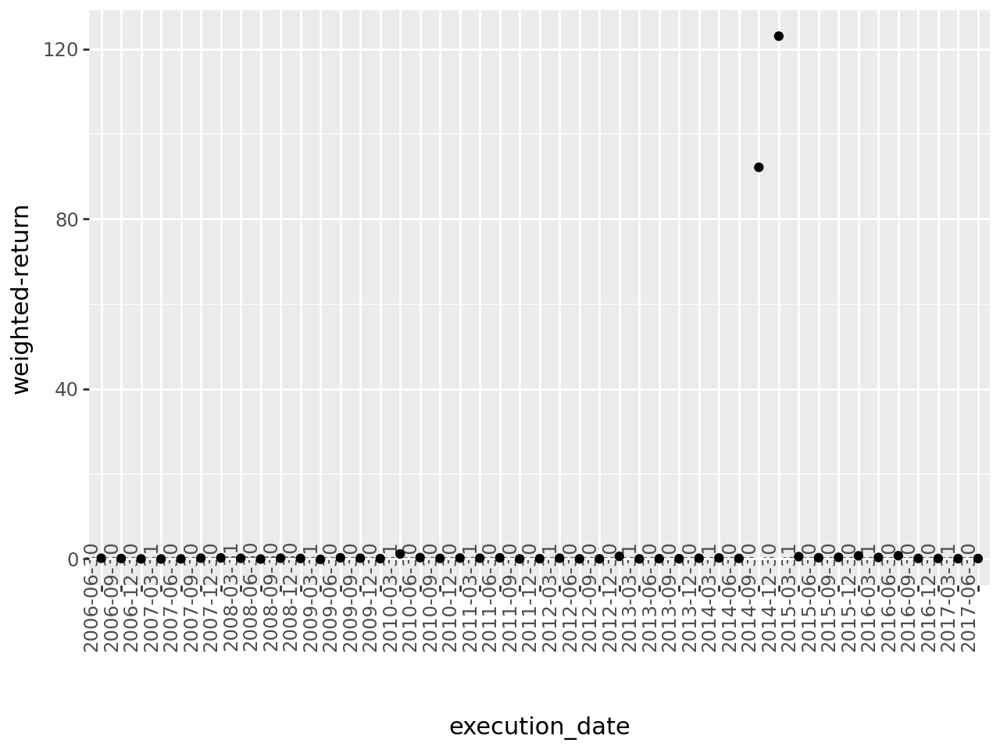

In [20]:
ggplot(test_results_final_tree) + geom_point(aes(x = "execution_date", y = "weighted-return")) + theme(axis_text_x = element_text(angle = 90, vjust = 0.5, hjust=1))



We can see that the model has improved a little just by all the performing withthe datset, but I believe I can improve it even more by doing feature selection. I will use SHAP for this purpose.

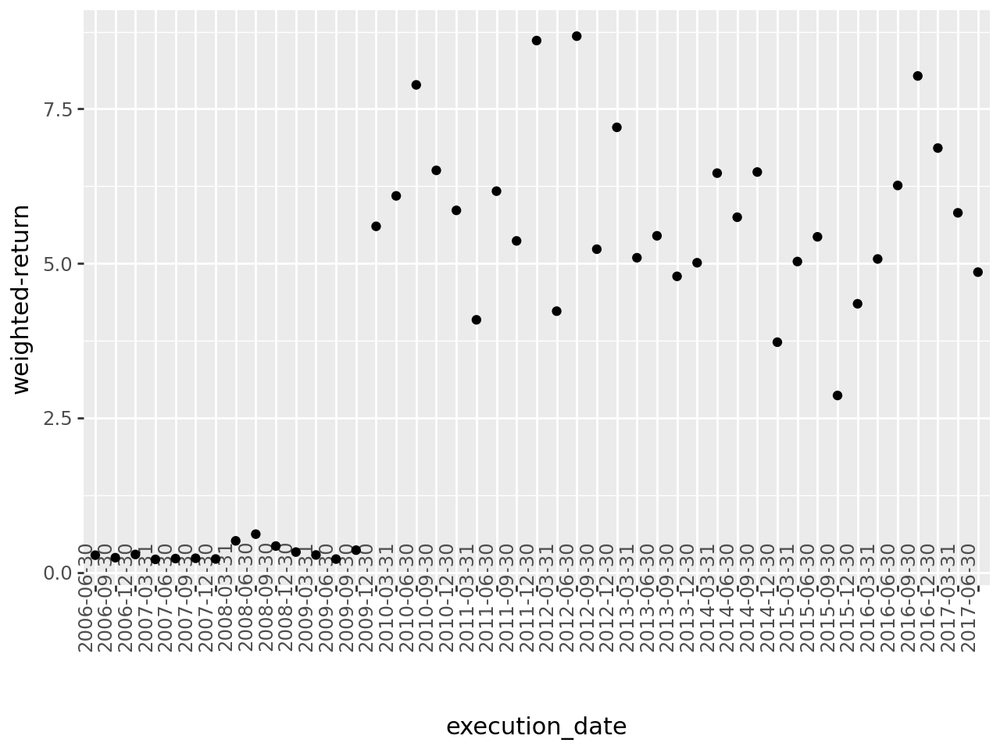

In [21]:
ggplot(train_results_final_tree) + geom_point(aes(x = "execution_date", y = "weighted-return")) + theme(axis_text_x = element_text(angle = 90, vjust = 0.5, hjust=1))


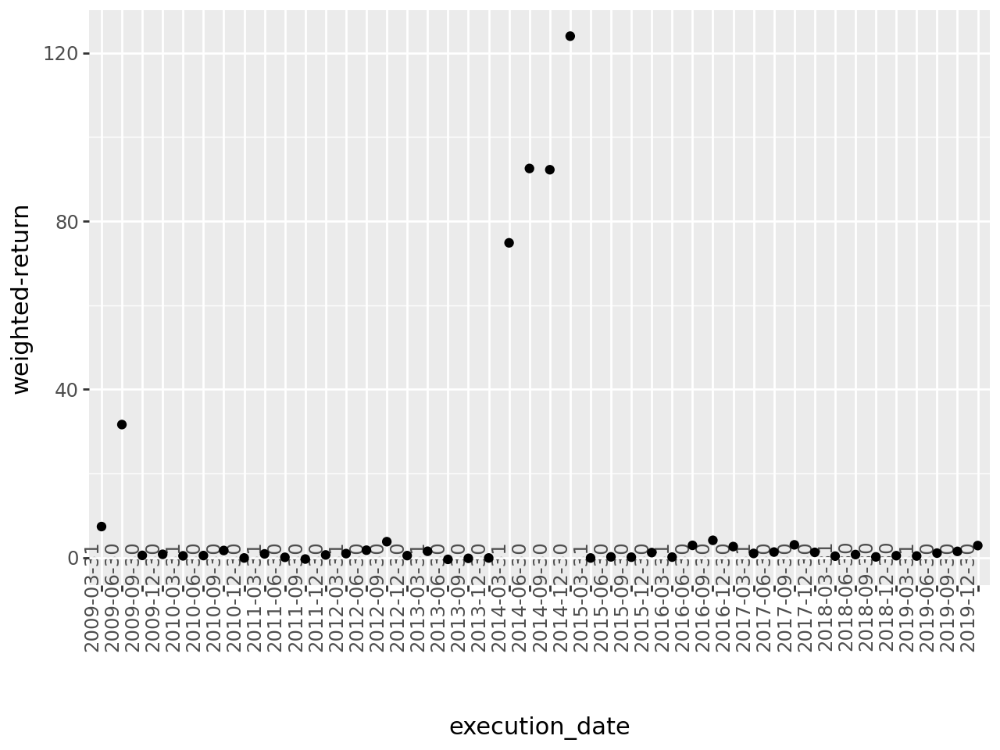

In [22]:
ggplot(test_results_final_tree_2) + geom_point(aes(x = "execution_date", y = "weighted-return")) + theme(axis_text_x = element_text(angle = 90, vjust = 0.5, hjust=1))

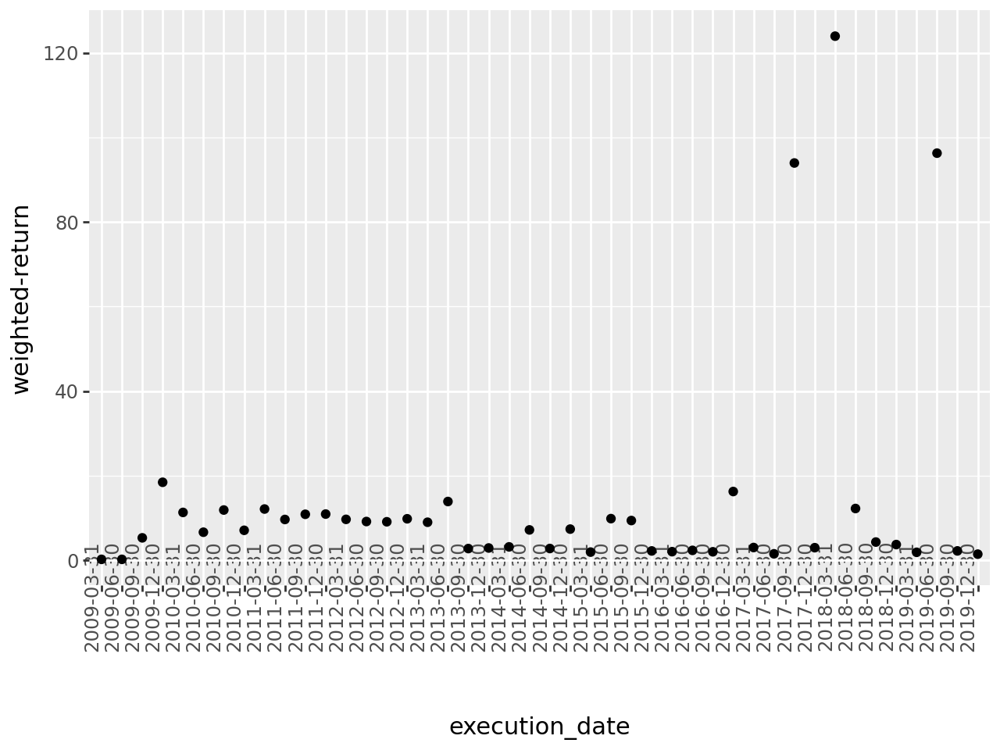

In [23]:
ggplot(train_results_final_tree_2) + geom_point(aes(x = "execution_date", y = "weighted-return")) + theme(axis_text_x = element_text(angle = 90, vjust = 0.5, hjust=1))

We have trained the first models for all the periods for you, but there are a lot of things which may be wrong or can be improved. Some ideas where you can start:
* Try to see if there is any kind of data leakage or suspicious features
* If the training part is very slow, try to see how you can modify it to execute faster tests
* Try to understand if the algorithm is learning correctly
* We are using a very high level metric to evaluate the algorithm so you maybe need to use some more low level ones
* Try to see if there is overfitting
* Try to see if there is a lot of noise between different trainings
* To simplify, why if you only keep the first tickers in terms of Market Cap?
* Change the number of quarters to train in the past

This function can be useful to compute the feature importance:

In [24]:
def draw_feature_importance(model,top = 15):
    fi = model.feature_importance()
    fn = model.feature_name()
    feature_importance = pd.DataFrame([{"feature":fn[i],"imp":fi[i]} for i in range(len(fi))])
    feature_importance = feature_importance.sort_values("imp",ascending = False).head(top)
    feature_importance = feature_importance.sort_values("imp",ascending = True)
    plot = ggplot(feature_importance,aes(x = "feature",y  = "imp")) + geom_col(fill = "lightblue") + coord_flip() +  scale_x_discrete(limits = feature_importance["feature"])
    return plot


## MY CODE FOR FEATURE IMPORTANCE

I WILL USE THIS FUNCTION, BUT I WILL ALSO DO SHAP.

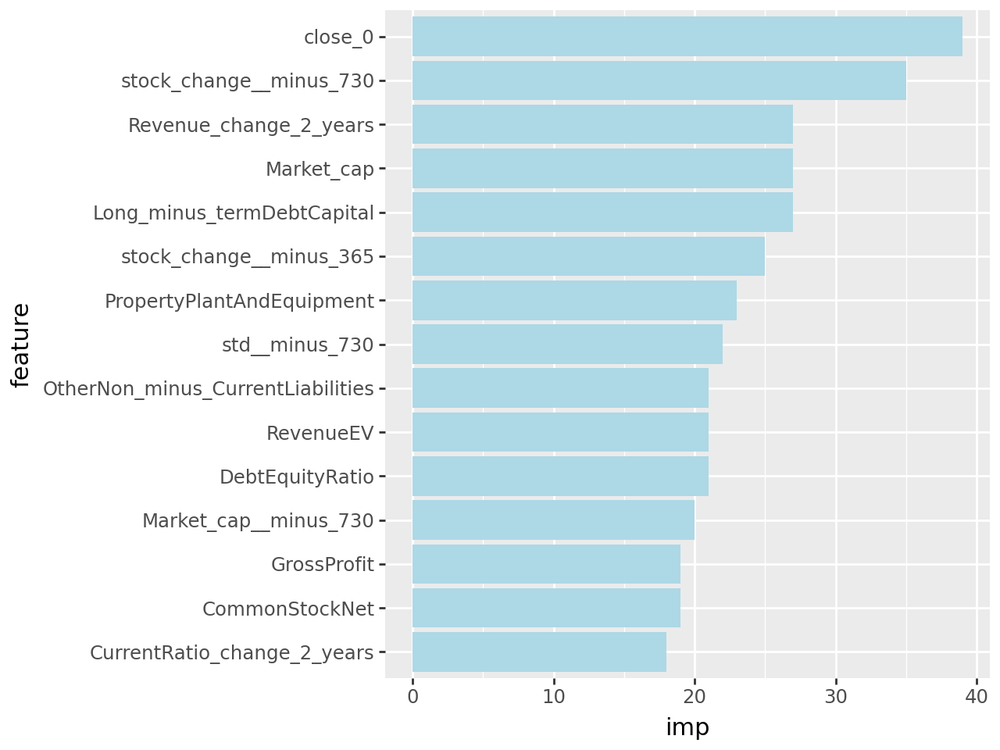

In [25]:

importances_plot = draw_feature_importance(model, top=15)
importances_plot



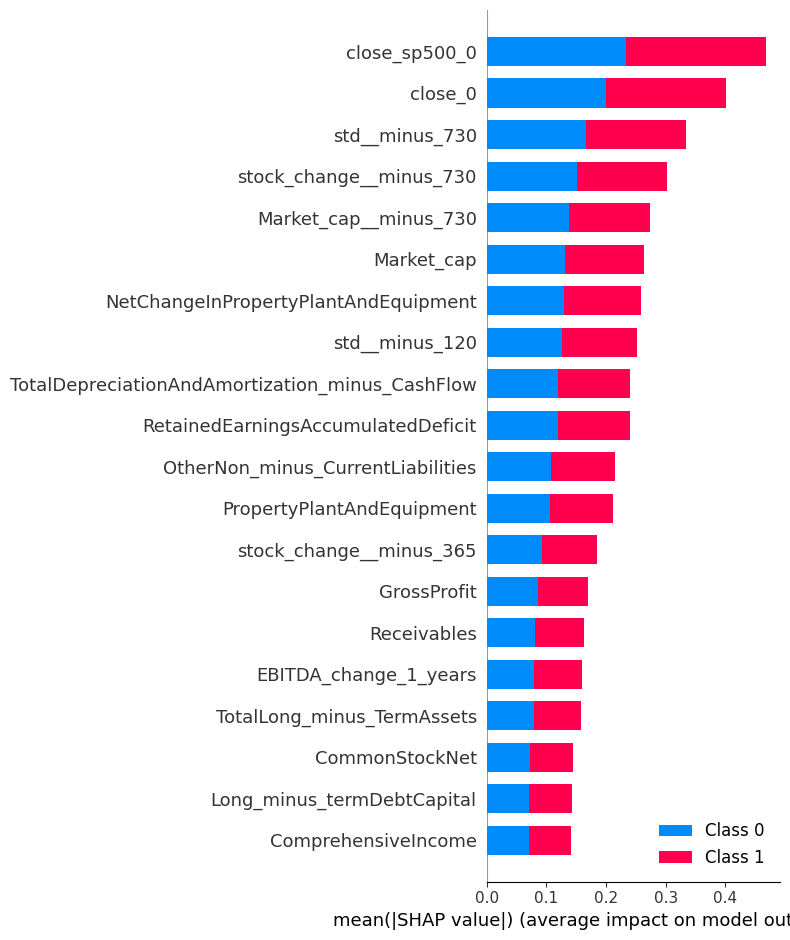

In [26]:
import shap
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_test)
shap.summary_plot(shap_values, X_test, plot_type="bar")

In [27]:
def split_train_test_by_period(data_set, test_execution_date,include_nulls_in_test = False):
    # we train with everything happening at least one year before the test execution date
    train_set = data_set.loc[data_set["execution_date"] <= pd.to_datetime(test_execution_date) - pd.Timedelta(350, unit = "day")]
    # remove those rows where the target is null
    train_set = train_set[~pd.isna(train_set["diff_ch_sp500"])]
    execution_dates = train_set.sort_values("execution_date")["execution_date"].unique()
    # Pick only the last n_train_quarters
    if n_train_quarters!=None:
        train_set = train_set[train_set["execution_date"].isin(execution_dates[-n_train_quarters:])]
        
    # the test set are the rows happening in the execution date with the concrete frequency
    test_set = data_set.loc[(data_set["execution_date"] == test_execution_date)]
    if not include_nulls_in_test:
        test_set = test_set[~pd.isna(test_set["diff_ch_sp500"])]
    test_set = test_set.sort_values('execution_date', ascending = False).drop_duplicates('Ticker_encoded', keep = 'first')
    
    return train_set, test_set

eliminating non-important features:

In [28]:
import pandas as pd
import numpy as np
import seaborn as sns

fi = model.feature_importance()
fn = model.feature_name()
feature_importances = pd.DataFrame({"feature": fn, "imp": fi})
feature_importances = feature_importances.sort_values("imp", ascending=False).head(15)
feature_importances = feature_importances.sort_values("imp", ascending=True)

threshold = 0.05

# Mantener 'execution_date' y 'Ticker' independientemente del umbral
features_to_keep = feature_importances[feature_importances['feature'].isin(['execution_date', 'Ticker']) 
                                        | (feature_importances['imp'] > threshold)]['feature']

# Asegúrate de que 'execution_date' esté en las características seleccionadas
#features_to_keep = list(set(features_to_keep) | {'execution_date'} | {'diff_ch_sp500'} |{'date'} )
from sklearn.preprocessing import LabelEncoder

# Assuming `df` is your DataFrame and it has a column named 'Ticker'
# Initialize the LabelEncoder
label_encoder = LabelEncoder()

# Fit and transform the 'Ticker' column, then replace it in the DataFrame
df_cleaned['Ticker_encoded'] = label_encoder.fit_transform(df_cleaned['Ticker'])
# Assuming `df` is your DataFrame and it has a column named 'target'
df_cleaned['target'] = df_cleaned['target'].astype(float)

# Now the 'target' column will be of type float

features_to_keep = list(set(features_to_keep) | {'execution_date', 'diff_ch_sp500', 'date', 'Ticker_encoded','target'})
df_filtered = df_cleaned[features_to_keep]

correlation_matrix = df_filtered.corr()
upper = correlation_matrix.where(np.triu(np.ones(correlation_matrix.shape), k=1).astype(bool))
to_drop = [column for column in upper.columns if any(upper[column].abs() > 0.9) and column not in ['execution_date', 'Ticker']]
df_reduced = df_filtered.drop(columns=to_drop)

#print(df_reduced.head())
num_features2 = df_cleaned.shape[1]
print("Número de características en df antes de la selección:", num_features2)
num_features = df_reduced.shape[1]
print("Número de características en df_reduced, después de la reducción:", num_features)

print("Columnas en df_reduced:", df_reduced.columns)




Número de características en df antes de la selección: 137
Número de características en df_reduced, después de la reducción: 20
Columnas en df_reduced: Index(['Long_minus_termDebtCapital', 'CurrentRatio_change_2_years', 'close_0',
       'Ticker_encoded', 'date', 'GrossProfit', 'stock_change__minus_730',
       'RevenueEV', 'Market_cap', 'PropertyPlantAndEquipment',
       'stock_change__minus_365', 'DebtEquityRatio',
       'OtherNon_minus_CurrentLiabilities', 'diff_ch_sp500',
       'Revenue_change_2_years', 'std__minus_730', 'execution_date',
       'CommonStockNet', 'Market_cap__minus_730', 'target'],
      dtype='object')


Now, let's redo the process to check if with this feature selection there's even more improvement:

In [29]:
all_results = {}
all_predicted_tickers_list = []
all_models = {}

execution_dates = np.sort(df_reduced['execution_date'].unique())

for execution_date in execution_dates:
    print(execution_date)
    all_results,all_predicted_tickers_list,all_models,model,X_train,X_test = run_model_for_execution_date(df_reduced,execution_date,all_results,all_predicted_tickers_list,all_models,n_trees,False)
all_predicted_tickers = pd.concat(all_predicted_tickers_list) 

test_results_3 = parse_results_into_df("valid_0")
train_results_3 = parse_results_into_df("training")

test_results_final_tree = test_results_3.sort_values(["execution_date","n_trees"]).drop_duplicates("execution_date",keep = "last")
train_results_final_tree = train_results_3.sort_values(["execution_date","n_trees"]).drop_duplicates("execution_date",keep = "last")

print(test_results_final_tree.head())

2008-03-31T00:00:00.000000000
2008-06-30T00:00:00.000000000
2008-09-30T00:00:00.000000000
2008-12-30T00:00:00.000000000
2009-03-31T00:00:00.000000000
2009-06-30T00:00:00.000000000
2009-09-30T00:00:00.000000000
2009-12-30T00:00:00.000000000
2010-03-31T00:00:00.000000000
2010-06-30T00:00:00.000000000
2010-09-30T00:00:00.000000000
2010-12-30T00:00:00.000000000
2011-03-31T00:00:00.000000000
2011-06-30T00:00:00.000000000
2011-09-30T00:00:00.000000000
2011-12-30T00:00:00.000000000
2012-03-31T00:00:00.000000000
2012-06-30T00:00:00.000000000
2012-09-30T00:00:00.000000000
2012-12-30T00:00:00.000000000
2013-03-31T00:00:00.000000000
2013-06-30T00:00:00.000000000
2013-09-30T00:00:00.000000000
2013-12-30T00:00:00.000000000
2014-03-31T00:00:00.000000000
2014-06-30T00:00:00.000000000
2014-09-30T00:00:00.000000000
2014-12-30T00:00:00.000000000
2015-03-31T00:00:00.000000000
2015-06-30T00:00:00.000000000
2015-09-30T00:00:00.000000000
2015-12-30T00:00:00.000000000
2016-03-31T00:00:00.000000000
2016-06-30

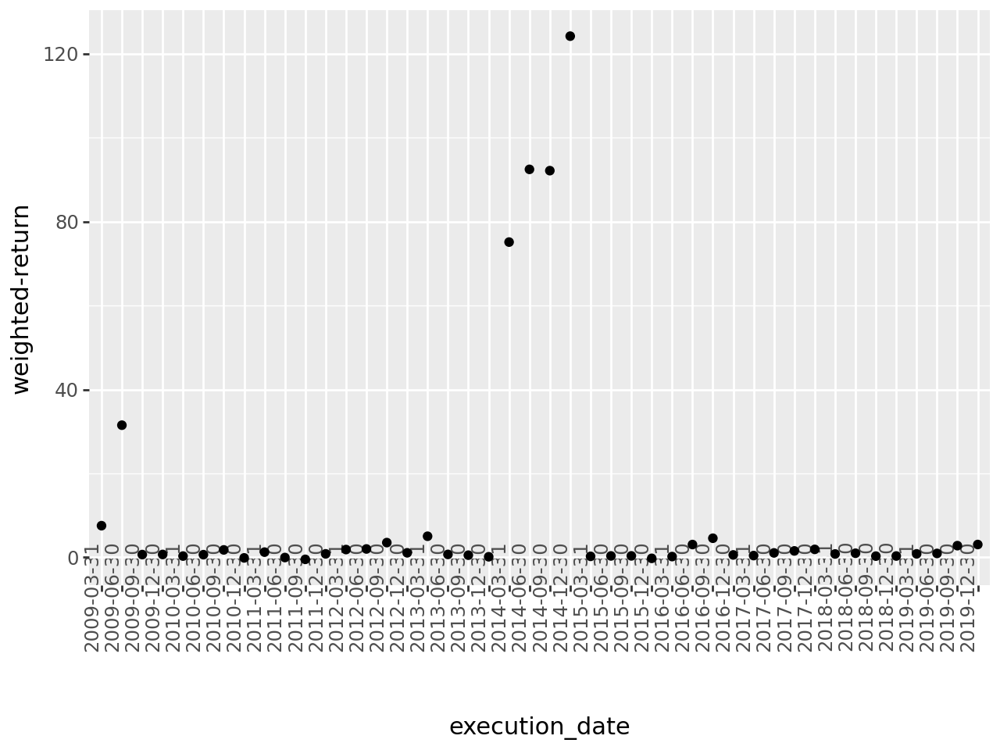

In [30]:


ggplot(test_results_final_tree) + geom_point(aes(x = "execution_date", y = "weighted-return")) + theme(axis_text_x = element_text(angle = 90, vjust = 0.5, hjust=1))






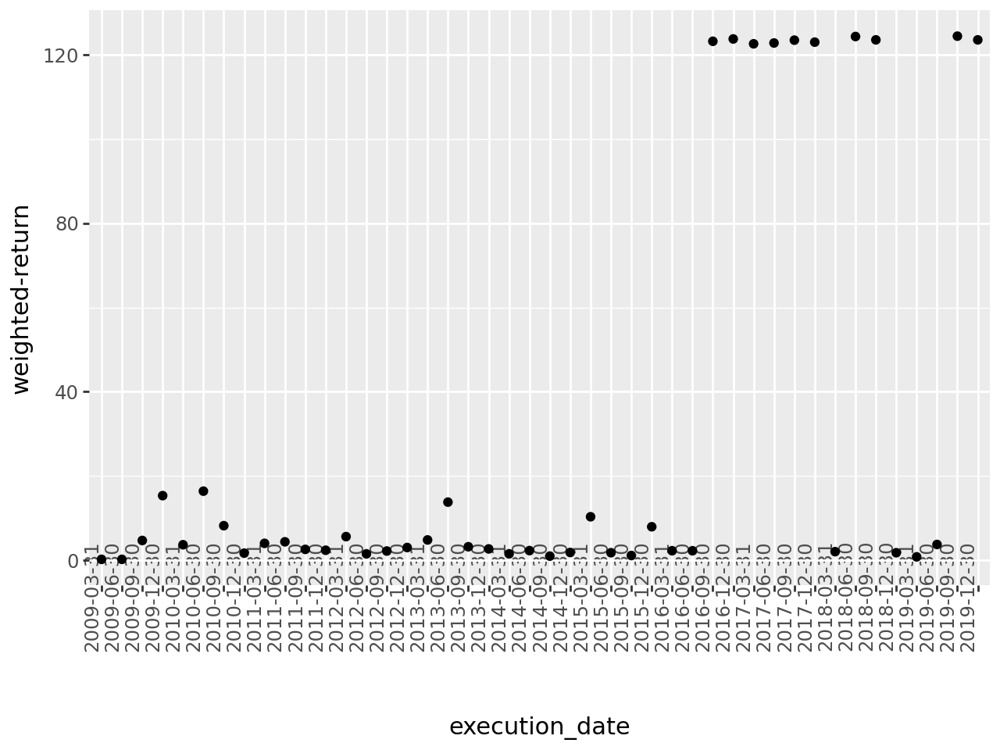

In [31]:
ggplot(train_results_final_tree) + geom_point(aes(x = "execution_date", y = "weighted-return")) + theme(axis_text_x = element_text(angle = 90, vjust = 0.5, hjust=1))

Let's evaluate some metrics:

In [34]:
def print_stats(df):
    mean_logloss = df['binary_logloss'].mean()
    mean_weighted_return = df['weighted-return'].mean()
    mean_top10_weighted_return = df['weighted-return'].nlargest(10).mean()
    
    print(f"Mean Log Loss: {mean_logloss}")
    print(f"Mean Weighted Return: {mean_weighted_return}")
    print(f"Mean of Top 10 Weighted Return: {mean_top10_weighted_return}")
print("test results df of 100 tickers with no nans but no feat reduction:")
print_stats(test_results_2)
print("-------------------------------")
print("train results df of 100 tickers with no nans but no feat reduction:")
print_stats(train_results_2)
print("-------------------------------")
print("test results with df reduced in features:")
print_stats(test_results_3)
print("-------------------------------")
print("train results with df reduced in features:")
print_stats(train_results_3)

test results df of 100 tickers with no nans but no feat reduction:
Mean Log Loss: 0.7707308752081998
Mean Weighted Return: 10.310534878977911
Mean of Top 10 Weighted Return: 124.01011624986566
-------------------------------
train results df of 100 tickers with no nans but no feat reduction:
Mean Log Loss: 0.33834867190037327
Mean Weighted Return: 9.551139990498676
Mean of Top 10 Weighted Return: 137.41338913165401
-------------------------------
test results with df reduced in features:
Mean Log Loss: 0.760346043030955
Mean Weighted Return: 10.451995918555305
Mean of Top 10 Weighted Return: 124.29353272849865
-------------------------------
train results with df reduced in features:
Mean Log Loss: 0.38010766091076426
Mean Weighted Return: 24.163688314689885
Mean of Top 10 Weighted Return: 190.8871814924152


we can see how the model has improved with not only the first approach which was to take 100 tickers (the best ones) and a df with no Nans, but also with the feature selection, since log loss is smaller and the mean is bigger

In [26]:
from scipy.stats import lognorm
import matplotlib.pyplot as plt

## SOME ANALYSIS OF THE MISSING VALUES

COUNTING NANS PER VARIABLE:

In [ ]:
import pandas as pd
import numpy as np
import logging
logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')
df = pd.DataFrame(data_set)
nan_count = df.isna().sum()
logging.info("missing values per feature:\n%s", nan_count)

2024-03-03 12:03:12,716 - INFO - missing values per feature:
Ticker                                 0
date                                   0
AssetTurnover                       7114
CashFlowFromFinancialActivities     1940
CashFlowFromInvestingActivities     1930
                                   ...  
Market_cap__minus_365              15242
Market_cap__minus_730              29386
diff_ch_sp500                      14217
count                                  0
target                             14217
Length: 146, dtype: int64


COUNTING EXECUTION DATES WITH MORE NANS

In [ ]:
import pandas as pd
import logging
from pandas.tseries.offsets import MonthEnd

logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s: %(message)s')

df['execution_date'] = pd.to_datetime(df['execution_date'])

nan_count_by_execution_date = df.groupby('execution_date').apply(lambda x: x.isna().sum()).sum(axis=1)
    
def analyze_nans_by_period(df, months):
    period_df = df.resample(f'{months}M', on='execution_date').apply(lambda x: x.isna().sum()).sum(axis=1)
    top_periods = period_df.sort_values(ascending=False).head(3)
    return top_periods

for months, period_name in zip([3, 6, 12, 18], ['quarter', 'semester', 'year']):
    top_periods = analyze_nans_by_period(df, months)
    logging.info(f"")
    logging.info(f"3 first periods for {period_name} with more NaNs:")
    for end_date, count in top_periods.items():
        logging.info("finishing on: %s, Total NaNs: %d", (end_date - MonthEnd(1)).date(), count)

/tmp/ipykernel_2386/2070158607.py:9: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
/tmp/ipykernel_2386/2070158607.py:12: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
2024-03-03 12:03:16,712 - INFO - 
2024-03-03 12:03:16,713 - INFO - 3 first periods for quarter with more NaNs:
2024-03-03 12:03:16,714 - INFO - finishing on: 2020-05-31, Total NaNs: 113163
2024-03-03 12:03:16,716 - INFO - finishing on: 2020-11-30, Total NaNs: 95979
2024-03-03 12:03:16,717 - INFO - finishing on: 2020-08-31, Total NaNs: 95231
/tmp/ipykernel_2386/2070158607.py:12: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
2024-03

In [10]:
import pandas as pd
import numpy as np

def consecutive_nans(df, umbral=1485):
    time_ranges = {}
    for column in df.columns:
        if column != 'execution_date':  
            nans = df[column].isna()
            secuencia_nans = nans.groupby(nans.diff().ne(False).cumsum()).cumsum()
        
            secuencias_largas = secuencia_nans[secuencia_nans > umbral]
            
            if not secuencias_largas.empty:
    
                for grupo, longitud in secuencias_largas.groupby(secuencia_nans).max().items():
                    inicio = df['execution_date'][secuencias_largas[secuencias_largas == grupo].index[0]]
                    fin = df['execution_date'][secuencias_largas[secuencias_largas == grupo].index[-1]]
                    if column in time_ranges:
                        time_ranges[column].append((inicio, fin))
                    else:
                        time_ranges[column] = [(inicio, fin)]
    
    return time_ranges

rangos_de_nans = consecutive_nans(df)
for column, rangos in rangos_de_nans.items():
    print(f"{column}: time ranges with a big number of consecutive NaNs:")
    for rango in rangos:
        print(f"    Desde {rango[0]} hasta {rango[1]}")

EBITDAMargin: time ranges with a big number of consecutive NaNs:
    Desde 2005-06-30 00:00:00 hasta 2005-06-30 00:00:00
    Desde 2005-06-30 00:00:00 hasta 2005-06-30 00:00:00
    Desde 2005-06-30 00:00:00 hasta 2005-06-30 00:00:00
    Desde 2005-06-30 00:00:00 hasta 2005-06-30 00:00:00
    Desde 2005-06-30 00:00:00 hasta 2005-06-30 00:00:00
    Desde 2005-06-30 00:00:00 hasta 2005-06-30 00:00:00
    Desde 2005-06-30 00:00:00 hasta 2005-06-30 00:00:00
    Desde 2005-06-30 00:00:00 hasta 2005-06-30 00:00:00
    Desde 2005-06-30 00:00:00 hasta 2005-06-30 00:00:00
    Desde 2005-06-30 00:00:00 hasta 2005-06-30 00:00:00
    Desde 2005-06-30 00:00:00 hasta 2005-06-30 00:00:00
    Desde 2005-06-30 00:00:00 hasta 2005-06-30 00:00:00
    Desde 2005-06-30 00:00:00 hasta 2005-06-30 00:00:00
    Desde 2005-06-30 00:00:00 hasta 2005-06-30 00:00:00
    Desde 2005-06-30 00:00:00 hasta 2005-06-30 00:00:00
    Desde 2005-06-30 00:00:00 hasta 2005-06-30 00:00:00
    Desde 2005-06-30 00:00:00 hasta 200

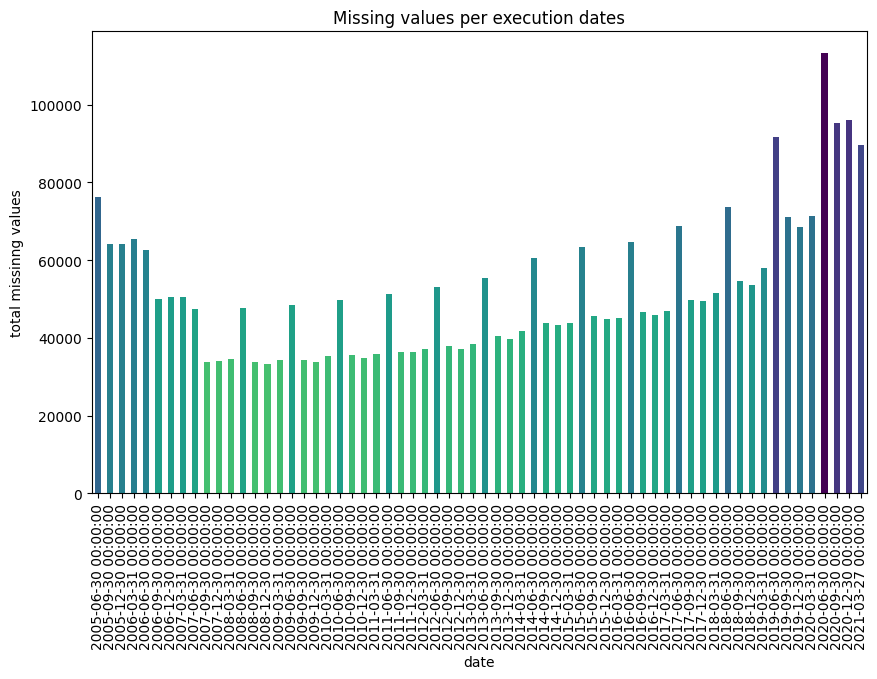

In [11]:
import matplotlib.pyplot as plt

df['execution_date'] = pd.to_datetime(df['execution_date'])

missing_values = df.set_index('execution_date').isnull().sum(axis=1).groupby('execution_date').sum()

colors = plt.cm.viridis_r((missing_values / missing_values.max()).values)

ax = missing_values.plot(kind='bar', color=colors, figsize=(10, 6))
ax.set_xlabel('date')
ax.set_ylabel('total missinng values')
ax.set_title('Missing values per execution dates')

plt.show()

WE CAN SEE THE CASCADE OF THE NANS DUE TO THE DEPENDENCY OF THE FUTURE ON PAST RESULTS

CREATING OUR REDUCED DATASET FOR APPLYING THE MODEL, WITH NO NANS AND ONLY THE BEST 100 TICKERS ACCORDING TO THEIR DIFF VARIABLE THROUGH ALL THE DATASET.

N tickers:  100


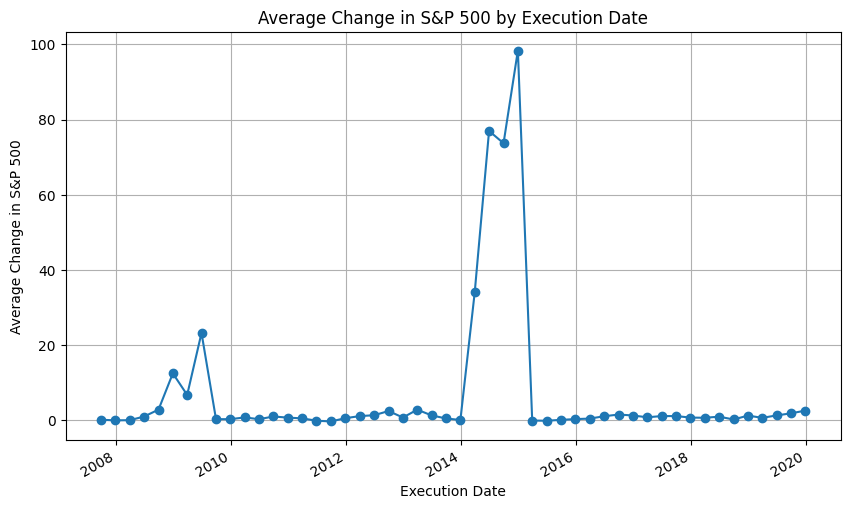

consecutive nans: std_730                     337
sp500_change_730            267
stock_change_730            267
stock_change_div_730        267
CommonStockDividendsPaid     17
                           ... 
n_finan_prev_year             0
PE                            0
sp500_change__minus_730       0
Market_cap                    0
NetIncomeLoss                 0
Length: 136, dtype: int64


<Figure size 1200x600 with 0 Axes>

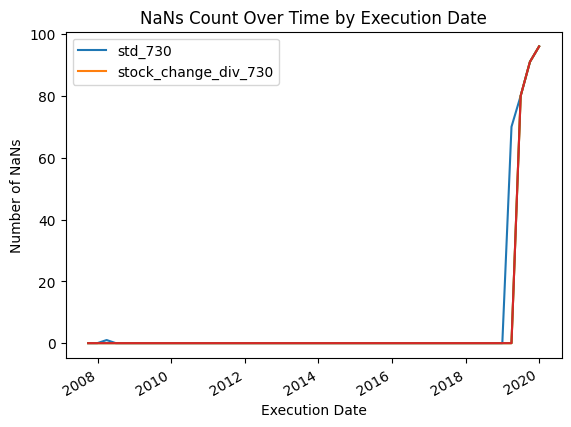

LongTermDebt                       5
Long_minus_termDebtCapital         5
ComprehensiveIncome                2
FinancialActivities_minus_Other    1
InvestingActivities_minus_Other    1
                                  ..
NetTotalEquityIssuedRepurchased    0
NetProfitMargin                    0
NetIncomeLoss                      0
NetIncome                          0
ROI_minus_ReturnOnInvestment       0
Length: 136, dtype: int64
total nans:  0


In [8]:
import pandas as pd
import numpy as np
import logging
import matplotlib.pyplot as plt
from sklearn.neighbors import LocalOutlierFactor

logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')
df = pd.DataFrame(data_set)
df_copy=df.copy()
nans_per_feature = df.isna().sum()

#getting out features over this threshold
threshold = len(df_copy) * 0.5
features_to_drop = nans_per_feature[nans_per_feature > threshold].index
df_cleaned = df_copy.drop(columns=features_to_drop)

#there is features with values from even two years before in time. Of course these will be Nan for the first years since there
#is no records of values. So let's get ride of the two first years in the datset
df_cleaned['execution_date'] = pd.to_datetime(df_cleaned['execution_date'])
cutoff_date = df_cleaned['execution_date'].min() + pd.DateOffset(years=2)
df_cleaned = df_cleaned[df_cleaned['execution_date'] > cutoff_date]

#same idea here, the last year has features with values of the following year (one of these used to calculate the target)
max_date = df_cleaned['execution_date'].max()
one_year_before_max = max_date - pd.DateOffset(years=1)
df_cleaned = df_cleaned[df_cleaned['execution_date'] <= one_year_before_max]




#if for any of these features are missing values, : LOFC
nans_stock_change = df_cleaned['stock_change_div_365'].isna().sum()
nans_sp500_change = df_cleaned['sp500_change_365'].isna().sum()
df_cleaned['stock_change_div_365'] = df_cleaned['stock_change_div_365'].fillna(df_cleaned['stock_change_div_365'].median())
lof = LocalOutlierFactor()
outliers = lof.fit_predict(df_cleaned[['stock_change_div_365']])
top_tickers = df_cleaned.groupby('Ticker')['diff_ch_sp500'].mean().nlargest(100).index
df_cleaned = df_cleaned[df_cleaned['Ticker'].isin(top_tickers)]
distinct_tickers = df_cleaned['Ticker'].nunique()
print("N tickers: ", distinct_tickers)


mean_diff_by_date = df_cleaned.groupby('execution_date')['diff_ch_sp500'].mean()
plt.figure(figsize=(10, 6))
mean_diff_by_date.plot(kind='line', marker='o')
plt.title('Average Change in S&P 500 by Execution Date')
plt.xlabel('Execution Date')
plt.ylabel('Average Change in S&P 500')
plt.grid(True)
plt.show()

#checking consecutive nans now:
def max_consecutive_nans(series):
    return (series.isna().astype(int).groupby(series.notna().astype(int).cumsum()).sum().max())
max_nans_by_feature = df_cleaned.apply(max_consecutive_nans)
max_nans_by_feature_sorted = max_nans_by_feature.sort_values(ascending=False)

print("consecutive nans:",max_nans_by_feature_sorted)



#graph of distribution of nans of features with consecutives Nans oover time
features_with_consecutive_nans_graph = ['std_730', 'stock_change_div_730']
nans_by_date = df_cleaned.set_index('execution_date')[['std_730', 'sp500_change_730', 'stock_change_730', 'stock_change_div_730']].isna().groupby(level=0).sum()
plt.figure(figsize=(12, 6))
nans_by_date.plot(kind='line')
plt.title('NaNs Count Over Time by Execution Date')
plt.xlabel('Execution Date')
plt.ylabel('Number of NaNs')
plt.legend(['std_730', 'stock_change_div_730'])
plt.show()

#applying ffil() since there is for almost alldatset not consecutive nans
df_cleaned = df_cleaned.ffill()
max_nans_by_feature = df_cleaned.apply(max_consecutive_nans)
max_nans_by_feature_sorted = max_nans_by_feature.sort_values(ascending=False)
print(max_nans_by_feature_sorted)

#getting 2007 out since all Nans now are in that year and we start our analysis from 2008, which is also good starting point
df_cleaned= df_cleaned[df_cleaned['execution_date'] >= pd.Timestamp('2008-01-01')]
nans_rows = df_cleaned[df_cleaned.isna().any(axis=1)]
features_with_nans_and_dates = [(column, row['execution_date']) for index, row in nans_rows.iterrows() for column in nans_rows.columns if pd.isna(row[column])]


#checking total nans :
total_nans = df_cleaned.isna().sum().sum()
print("total nans: ",total_nans)

NOW WE HAVE OUR DATSAET REDUCED, FOCUSING ONLY ON THE BEST TICKERS, AND WITH NO NANS., and with the best 100 tickers

In [10]:
def run_model_for_execution_date(data_set,execution_date,all_results,all_predicted_tickers_list,all_models,n_estimators,include_nulls_in_test = False):
        global train_set
        global test_set
        # split the dataset between train and test
        train_set, test_set = split_train_test_by_period(data_set,execution_date,include_nulls_in_test = include_nulls_in_test)
        train_size, _ = train_set.shape
        test_size, _ = test_set.shape
        model = None
        X_train = None
        X_test = None
        
        # if both train and test are not empty
        if train_size > 0 and test_size>0:
            model, evals_result, X_train, X_test = train_model(train_set,
                                                              test_set,
                                                              n_estimators = n_estimators)
            
            test_set['prob'] = model.predict(X_test)
            predicted_tickers = test_set.sort_values('prob', ascending = False)
            predicted_tickers["execution_date"] = execution_date
            all_results[(execution_date)] = evals_result
            all_models[(execution_date)] = model
            all_predicted_tickers_list.append(predicted_tickers)
        return all_results,all_predicted_tickers_list,all_models,model,X_train,X_test


execution_dates = np.sort( data_set['execution_date'].unique() )

Now, by modifying the model function provided, we are going to apply this model to the train, for later checking for features with not much importance with SHAP, and so getting ride of these features to have a more precise model. 

In [19]:
all_results = {}
all_predicted_tickers_list = []
all_models = {}

execution_dates = np.sort(df_cleaned['execution_date'].unique())

for execution_date in execution_dates:
    print(execution_date)
    all_results,all_predicted_tickers_list,all_models,model,X_train,X_test = run_model_for_execution_date(df_cleaned,execution_date,all_results,all_predicted_tickers_list,all_models,n_trees,False)
all_predicted_tickers = pd.concat(all_predicted_tickers_list) 
    

2008-03-31T00:00:00.000000000
2008-06-30T00:00:00.000000000
2008-09-30T00:00:00.000000000
2008-12-30T00:00:00.000000000
2009-03-31T00:00:00.000000000
2009-06-30T00:00:00.000000000
2009-09-30T00:00:00.000000000
2009-12-30T00:00:00.000000000
2010-03-31T00:00:00.000000000
2010-06-30T00:00:00.000000000
2010-09-30T00:00:00.000000000
2010-12-30T00:00:00.000000000
2011-03-31T00:00:00.000000000
2011-06-30T00:00:00.000000000
2011-09-30T00:00:00.000000000
2011-12-30T00:00:00.000000000
2012-03-31T00:00:00.000000000
2012-06-30T00:00:00.000000000
2012-09-30T00:00:00.000000000
2012-12-30T00:00:00.000000000
2013-03-31T00:00:00.000000000
2013-06-30T00:00:00.000000000
2013-09-30T00:00:00.000000000
2013-12-30T00:00:00.000000000
2014-03-31T00:00:00.000000000
2014-06-30T00:00:00.000000000
2014-09-30T00:00:00.000000000
2014-12-30T00:00:00.000000000
2015-03-31T00:00:00.000000000
2015-06-30T00:00:00.000000000
2015-09-30T00:00:00.000000000
2015-12-30T00:00:00.000000000
2016-03-31T00:00:00.000000000
2016-06-30